# Visualizing metadata (Python)
<small>Tutorial written by: Hannah-Marie Martiny (hanmar@food.dtu.dk)
<br>Last updated: 20-12-2021</small>

In this tutorial, a brief overview of the distribution of metadata variables and how to visualize them is given.



## Setup
The various settings that are sensitive are stored in a config.json file, but just change the settings to what fit your own setup.

In [1]:
import json
with open('../config.json', 'r') as source:
    config = json.load(source)

database=config['database'] # name of database
host=config['host'] # host address of MySQL server
port=config['port'] # port of MySQL server
user=config['user'] # user name
passwd=config['password'] # password for user 
dataDir=config['datadir'] # directory where data files are stored

Furthermore, we have put some of the common usely Python function into the folder [`src/`](../../src) to avoid repeating the same code all the time.

In [26]:
import sys
import matplotlib.pyplot as plt

sys.path.append('../..')
from src.funcs import *

## Load metadata
The metadata are available in either the MySQL table `metadata` or in TSV format in the file `metadata.tsv` and HDF5 format `metadata.h5`.

In [43]:
# Load the metadata from MySQL database
cli_args = f"--database={database} --host={host} --port={port} --user={user} --password={passwd}"
metadata = query_db("select * from metadata", args=cli_args)

metadata['collection_date'] = pd.to_datetime(metadata['collection_date'], errors='coerce')
metadata.loc[metadata['collection_date'] > '2020-01-01', 'collection_date'] = pd.NaT # cannot be later than this date

# combine host labels metagenome and metagenomes into one
metadata.loc[metadata['host'] == 'metagenomes', 'host'] = 'metagenome'

print("Shape of metadata dataframe:", metadata.shape)

Shape of metadata dataframe: (214022, 18)


## What metadata do we have?

There are a multitude of different metadata associated with each metagenomic dataset. Let's us see which columns we have:

In [23]:
metadata.columns

Index(['run_accession', 'sample_accession', 'project_accession', 'country',
       'location', 'continent', 'collection_date', 'tax_id', 'host',
       'host_tax_id', 'instrument_platform', 'instrument_model',
       'library_layout', 'raw_reads', 'trimmed_reads', 'raw_bases',
       'trimmed_bases', 'trimmed_fragments'],
      dtype='object')

The `run_accession` column contains the identifier for each metagenomic dataset and can be used to connect the mapping results to metadata (as seen in other tutorials).

In the paper, we have looked at the distribution of samples according to the following columns: `continent`, `host`, `collection_year` (from the `collection_date`), number of raw reads (`raw_reads`) vs trimmed reads (`trimmed_reads`). So let's replicate these figures.

### Distribution of metagenomes according to: `collection_year`

We first create the column `collection_year` from the `collection_date` column, and then we count the number of samples per year. Finally, we visualize these counts in a barplot with matplotlib.

<AxesSubplot:ylabel='collection_year'>

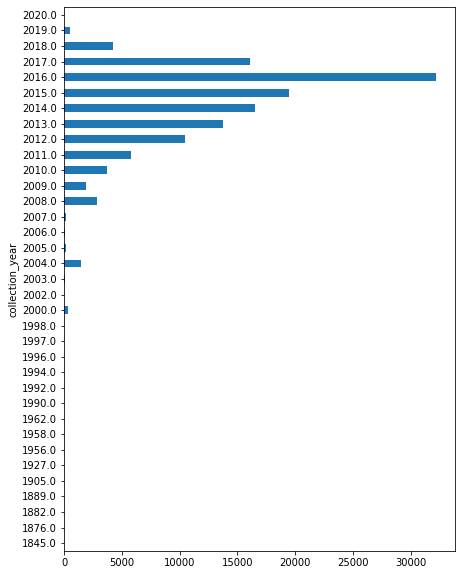

In [31]:
# create year column
metadata['collection_year'] = metadata['collection_date'].dt.year

# group data by year and count number of run_accessions
yearCounts = metadata.groupby('collection_year')['run_accession'].nunique()

# create barplot
yearCounts.plot.barh(figsize=(7,10))

### Distribution of metagenomes according to: `continent`
This is a pretty similar process as for looking at the distribution of samples according to sampling year, instead we just look at the `continent` labels.


<AxesSubplot:ylabel='continent'>

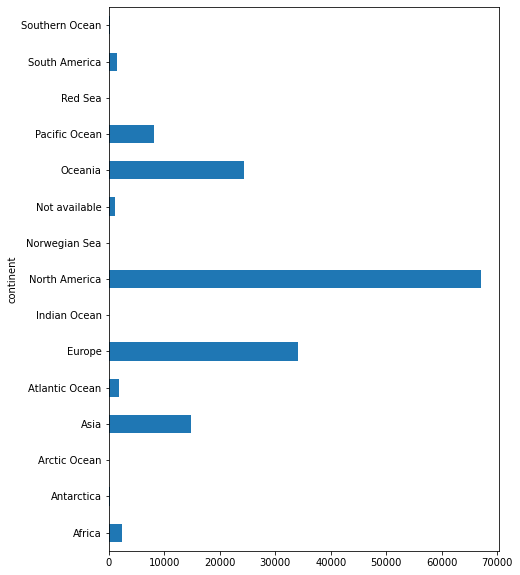

In [34]:
# group data by continent and count number of run_accessions
continentCounts=metadata.groupby('continent')['run_accession'].nunique()

# visualize in bar chart
continentCounts.plot.barh(figsize=(7, 10))

### Distribution of metagenomes according to: `host`
This is a pretty similar process as for looking at the distribution of samples according to sampling year, instead we just look at the `host` labels.

NOTE: There are many host labels, so let us look at the 20 most frequent ones. 


Number of unique hosts: 4654


<AxesSubplot:ylabel='host'>

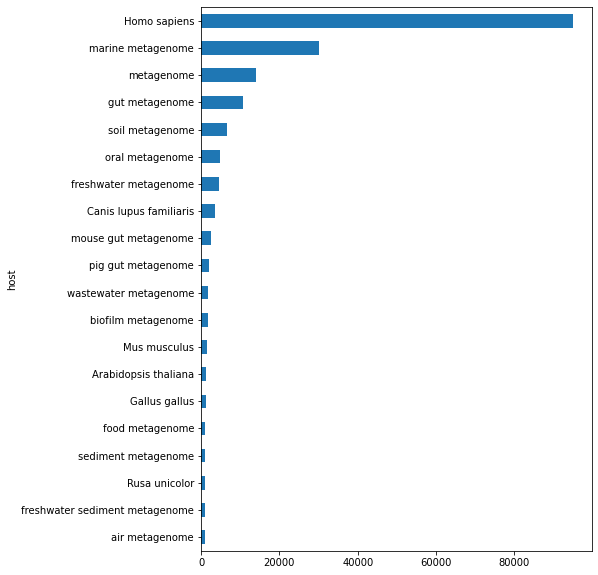

In [44]:
# group data by continent and count number of run_accessions
hostCounts=metadata.groupby('host')['run_accession'].nunique()
print("Number of unique hosts:", hostCounts.shape[0])

# look at top 20
hostCountsTop20 = hostCounts.sort_values().tail(20)

# visualize in bar chart
hostCountsTop20.plot.barh(figsize=(7, 10))

### Distribution of metagenomes according to: `raw_reads` and `trimmed_reads`.
Instead of making a bar plot, we can also look at the number of sequencing reads available before and after trimming in a scatter plot.


Text(0, 0.5, 'trimmed_reads')

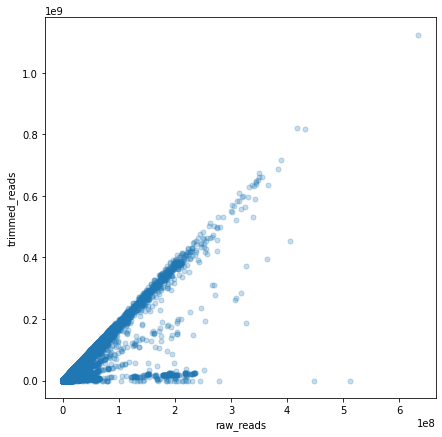

In [49]:
x='raw_reads'
y='trimmed_reads'

plt.figure(figsize=(7,7))
plt.plot(metadata[x], metadata[y], 'o', alpha=.25, ms=5)
plt.xlabel(x)
plt.ylabel(y)